# Partial overlaps for Wigner D-matrices 
#### ` Fingerprints for mixed quantum states` 
#### - Lázaro Alonso
 - Instituto de Física, Benemérita Universidad Autónoma de Puebla, Puebla, México, Sep 1, 2018 
___

> Here, the code necesary for plotting some pictures from the paper  [Eigenvalue Determination for Mixed Quantum States
using Overlap Statistics](https://arxiv.org/pdf/1808.00019.pdf) is shown. Similars to  `Fig. 4` in paper. 

___
<p style="text-align:justify"> Quantum state tomography deals with the complete characterization of an ensemble of identically and independently distributed quantum states. It involves the estimation of all elements of the density matrix describing that ensemble of states.

The method discussed in this notebook is based on measuring
the overlap between two mixed quantum states. Which requires two copies of the quantum state, the possibility to apply unitary transformations to one of these copies, and finally a measurement of the overlap between the two states. </p>

<p style="text-align:justify">
The overlap function for a mixed state $\varrho$, is written as 

\begin{equation}
Q(O,\varrho) = tr(O\varrho O^{\dagger} \varrho)
\end{equation}


over the whole unitary group. From here, we can define partials overlaps, see [paper](https://arxiv.org/pdf/1808.00019.pdf) for more details. 
 
Here, we are considering the situation when the sampling over all unitary transformations is not possible, i.e., SU(3) in the qutrit case. This amounts to consider a sub-group of SU(3) that can be parametrized by the respective Wigner D-matrices. </p>

\begin{equation}
D = \left( \begin{array}{ccc} 
      \frac{1 + \cos\beta}{2} e^{-i(\alpha + \gamma)} & 
      \frac{- e^{-i\alpha}}{\sqrt{2}} \sin\beta  & 
      \frac{1 - \cos\beta}{2} e^{-i(\alpha - \gamma)} \\ 
  \frac{e^{-i\gamma}}{\sqrt{2}}\sin\beta & 
  \cos\beta & 
  \frac{-e^{i\gamma}}{\sqrt{2}} \sin\beta \\ 
      \frac{1 - \cos\beta}{2} e^{i(\alpha - \gamma)} & 
      \frac{e^{i\alpha}}{\sqrt{2}} \sin\beta & 
      \frac{1 + \cos\beta}{2} e^{i(\alpha + \gamma)} \end{array} \right).
\end{equation}

In this case, the main expression for partial overlaps over D-matrices is as follows: 

\begin{equation}
t_{k} = \lambda_{1} |\,\tilde{D}_{1k}\,|^2 + \lambda_{2} |\,\tilde{D}_{3k}\,|^2 + \lambda_{3} |\,\tilde{D}_{3k}\,|^2
\end{equation}
where $\tilde{D} = U^{\dagger} D U$ with $U$ an unitary matrix. 



<p style="text-align:justify">
Afterwards, we obatain $(t_1, t_2)$ pairs with random angles $\alpha, \beta, \gamma$ from uniform distributions. 
In order to have a set of points we fixed some unitary matrix $U$ of eigenvectors and also the combination of eigenvalues to $\lambda_1 = 0.05, \lambda_2 = 0.3, \lambda_3 = 0.65$.</p>

### ` Show me the code ! `

In [1]:
import numpy as np, pandas as pd, datashader as ds
from datashader import transfer_functions as tf
from datashader.colors import inferno, viridis
from numba import jit
import numba
from functools import partial
from datashader.utils import export_image
background = "white"
import sys

In [2]:
ds.transfer_functions.Image.border = 0

For saving figures we use `partial` and `export_image`. 

In [3]:
img_map = partial(export_image, export_path="powd_dists", background=background)

#### Now,  we define a function to get a random unitary matrix, as follows: 

In [4]:
@jit
def unitaria(dim):
    U = np.random.randn(dim, dim) + 1j * np.random.randn(dim, dim)
    return np.linalg.eigh(U + U.conjugate().T)[1]

#### Let's define the `Wigner D matrix`

In [5]:
@jit
def D(α, β, γ):
    d = np.array([[np.exp(-1j*(α + γ))*(1 + np.cos(β))/2, 
                   -np.exp(-1j*α)*np.sin(β)/np.sqrt(2),
                np.exp(-1j*(α - γ))*(1 - np.cos(β))/2], 
                [np.exp(-1j*γ)*np.sin(β)/np.sqrt(2), 
                 np.cos(β), 
                 -np.exp(1j*γ)*np.sin(β)/np.sqrt(2)], 
                [np.exp(1j*(α - γ))*(1 - np.cos(β))/2, 
                 np.exp(1j*α)*np.sin(β)/np.sqrt(2),
                np.exp(1j*(α + γ))*(1 + np.cos(β))/2]])
    return d

#### Then, the transformation is 

In [6]:
@jit
def D_prime(unitary, α, β, γ):
    u_dagga = unitary.T.conj()
    return u_dagga@D(α, β, γ)@unitary

#### The set of eigenvalues is as follows

In [7]:
@jit
def lambdas(λ1, λ2):
    return np.array([λ1, λ2, 1 - λ1 - λ1])

#### And, our pair of $t's$ is 

In [8]:
@jit
def pair_ts(lambs, unitary):
    α, β = np.random.uniform(0, 2*np.pi), np.random.uniform(0, np.pi)
    γ = np.random.uniform(0, 2*np.pi)
    d_prime = D_prime(unitary, α, β, γ)
    t1 = np.sum(np.abs(d_prime[:,0])**2 * lambs)
    t2 = np.sum(np.abs(d_prime[:,1])**2 * lambs)
    return t1, t2

In [9]:
n = 10000000 # each picture will contain 10 million points

@jit 
def dist_ts(lambs, unitary, n=n):
    t1n, t2n = np.zeros(n), np.zeros(n)
    for i in range(n):
        t1n[i], t2n[i] = pair_ts(lambs, unitary)
    return pd.DataFrame(dict(t1 = t1n, t2 = t2n))

In [10]:
lambs = lambdas(0.05, .3); lambs

array([0.05, 0.3 , 0.9 ])

### Let's see how one pattern for a random unitary matrix looks like. 

In [11]:
np.random.seed(12) # you must have the same seed in order to have the same results
uniTest = unitaria(3)

In [12]:
uniTest

array([[ 0.3807379 +0.        j,  0.67769907+0.        j,
        -0.62909668+0.        j],
       [ 0.51453275-0.16973604j,  0.25091653-0.3215532 j,
         0.58170394-0.44912214j],
       [ 0.74191622+0.10509375j, -0.60664802+0.07966554j,
        -0.20449825+0.14942447j]])

In [13]:
df = dist_ts(lambs, uniTest) 

**Warning.**
It's not as fast I will like it to be, but still, the process is in a `single core.` If it's of interest to somebody, this code can easily be scalable to `multiple cores. `

In [14]:
df.head()

,t1,t2
0,0.243527,0.254443
1,0.591547,0.386359
2,0.316550,0.353342
3,0.223343,0.582045
4,0.549578,0.441214


Now, aggregate this points to our canvas... 

In [15]:
cvs = ds.Canvas(plot_width = 600, plot_height = 600) # a resolution of 600x600 gives you smoother pics
agg = cvs.points(df, 't1', 't2')

 So, we have our set of points, now we will plot this in a linear scale and a cropping at 200 counts per unit. The first round of plots is just to show the same pattern for different colormaps schemes. 

In [16]:
wb  = ["white", "black"]
wb2 = ["#ffffff","#f0f0f0","#d9d9d9","#bdbdbd","#969696","#737373","#525252","#252525","#000000"]

,,,

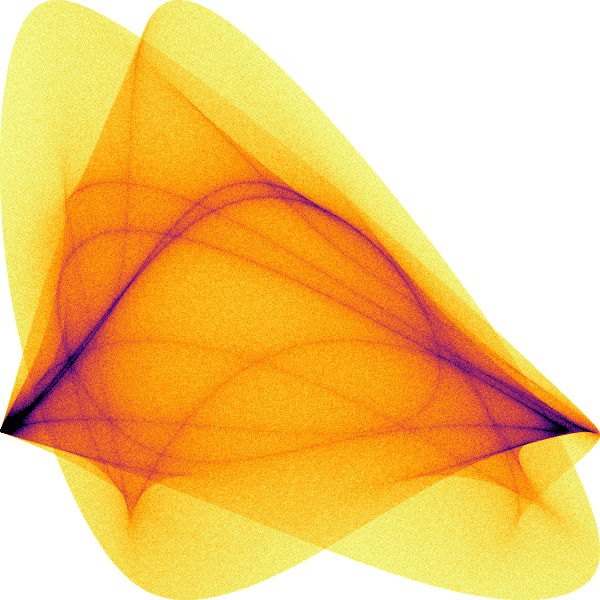
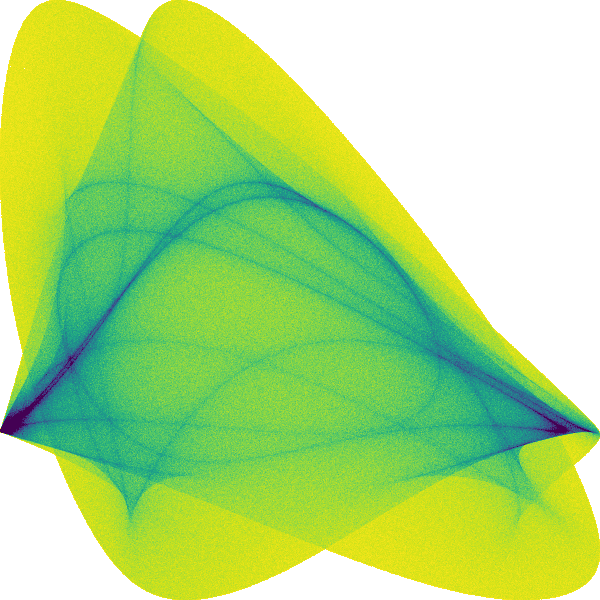
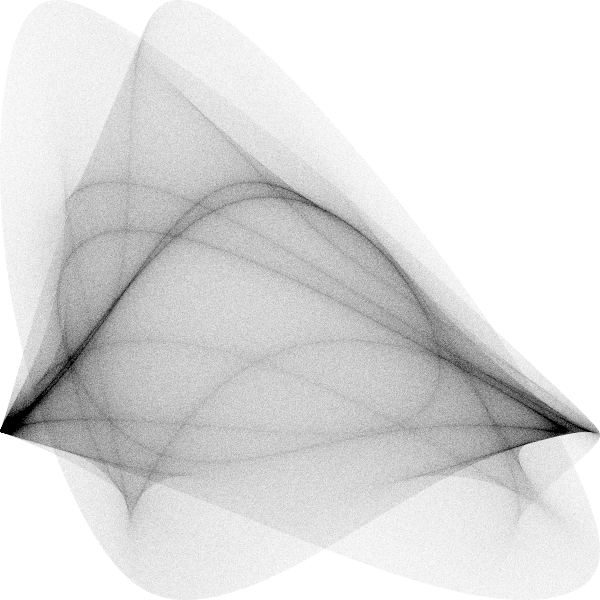
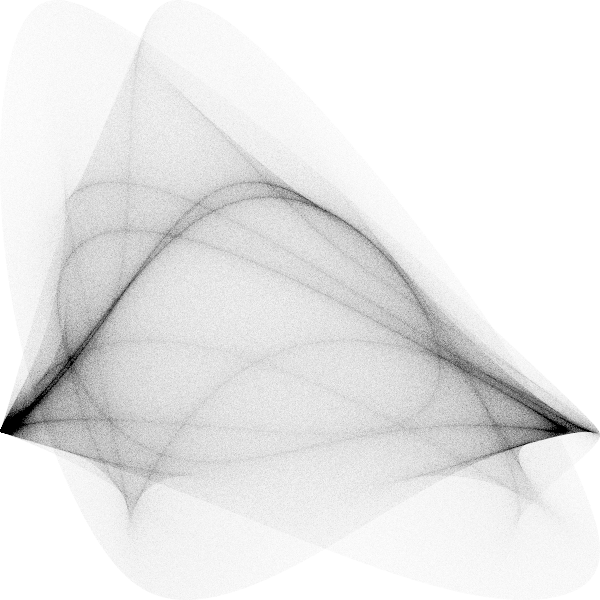

In [17]:
tf.Images(tf.shade(agg, cmap = inferno[::-1], how='linear',
               span=[0,200]),
         tf.shade(agg, cmap = viridis[::-1], how='linear',
               span=[0,200]),
         tf.shade(agg, cmap = wb,  how='linear', span=[0,200]),
          tf.shade(agg, cmap = wb2,  how='linear', span=[0,200])).cols(4)

Using `colorcet` we can have a larger set of cmaps. 

In [18]:
from colorcet import palette
cmaps =  [palette[p][::-1] for p in ['bgy', 'bmw', 'bmy','bgyw','kbc',
                                     'fire','kgy','dimgray' ]]
cmaps += [inferno[::-1], viridis[::-1]]

In [19]:
set0 = [tf.shade(agg, cmap = cmaps[i], how='linear',
               span=[0, 200]) for i in range(10)]

,,,,
,,,,

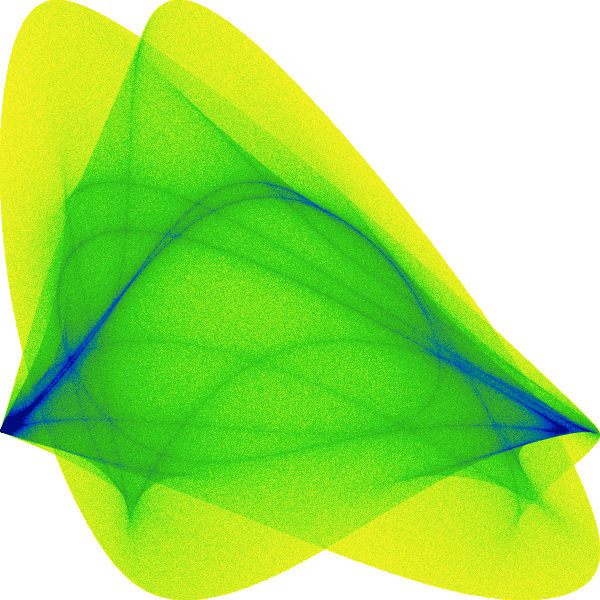
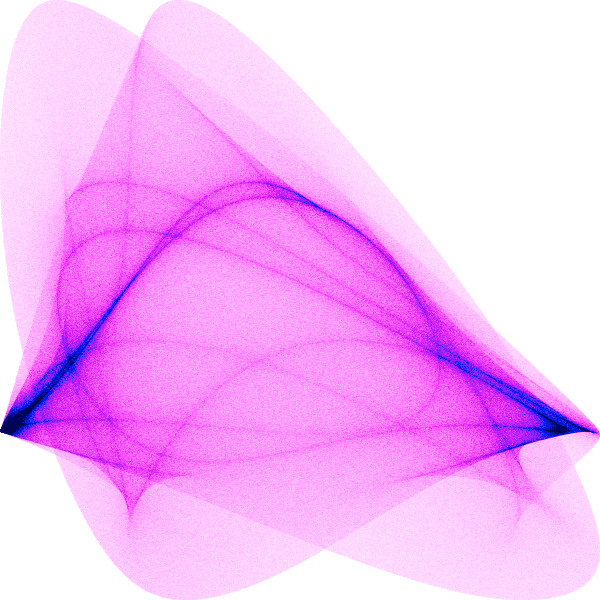
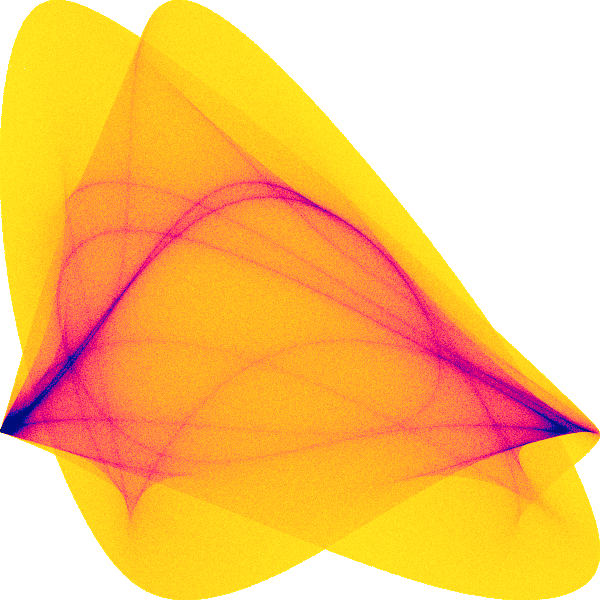
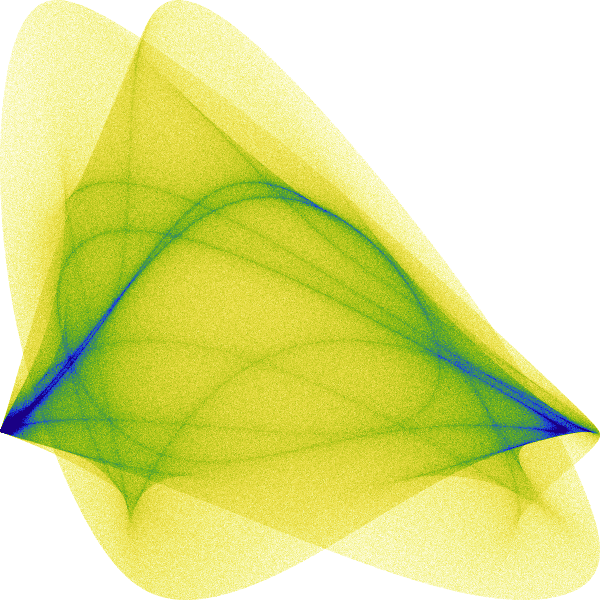
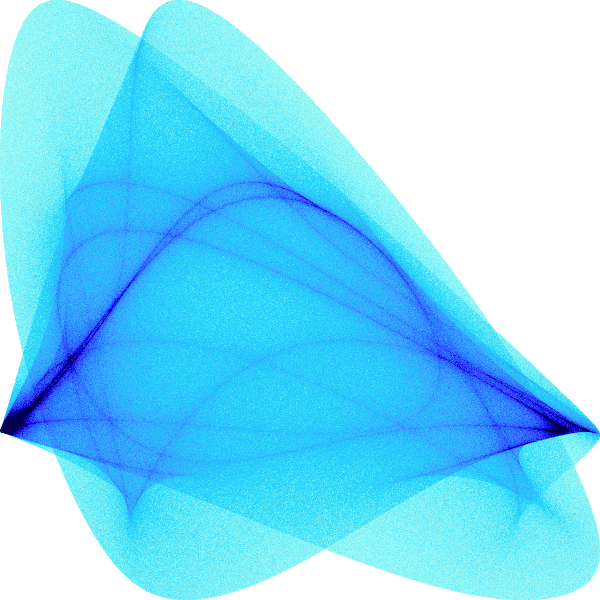
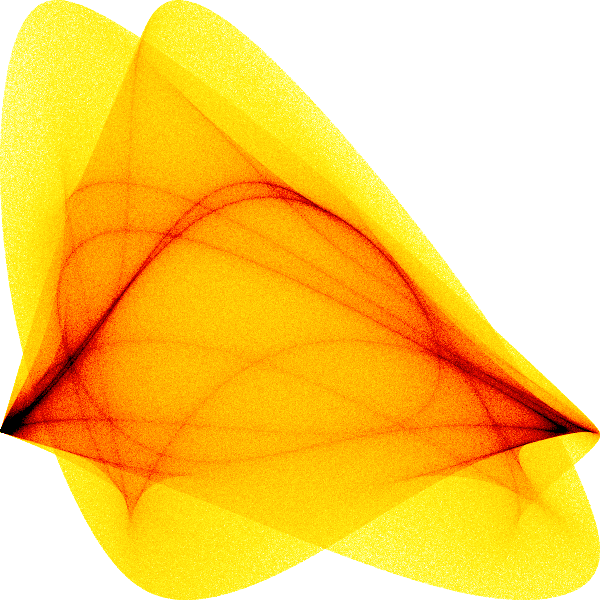
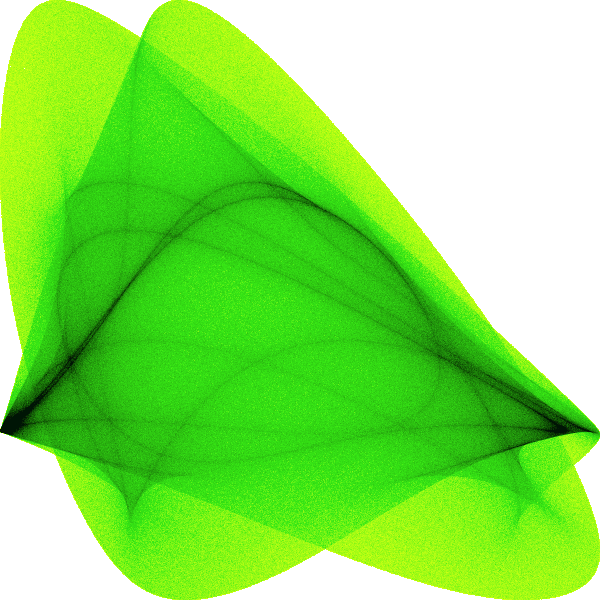
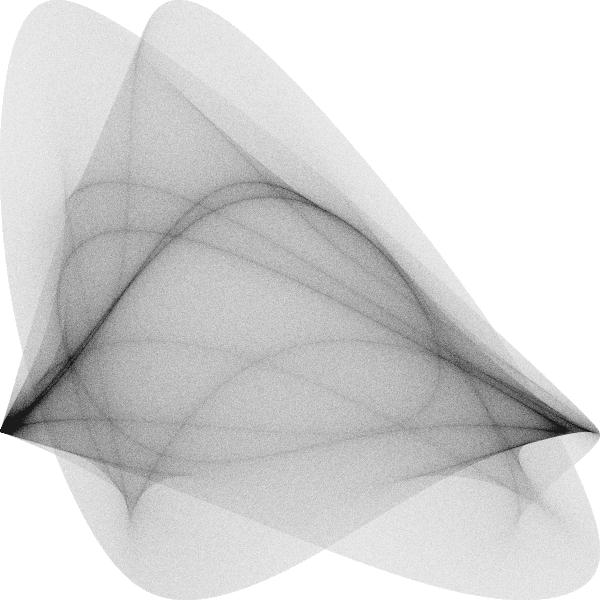
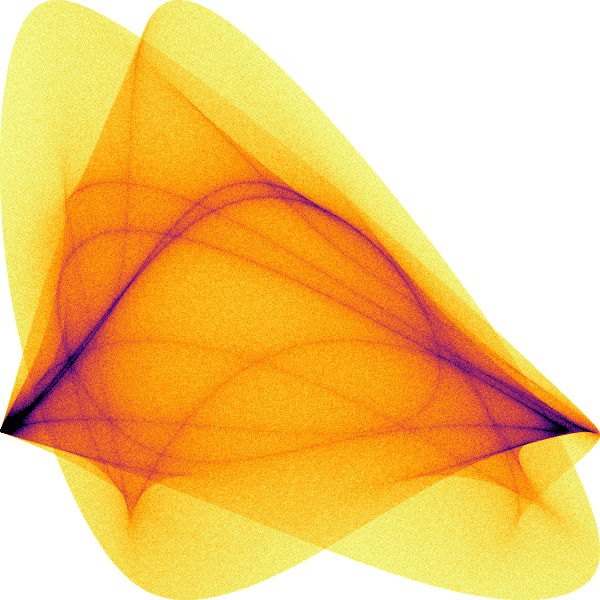
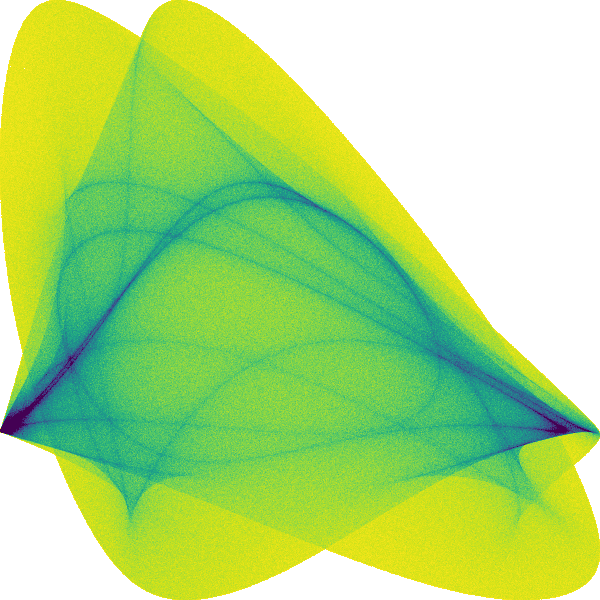

In [20]:
tf.Images(*set0).cols(5)

#### Saving each picture...

In [21]:
for indx in range(len(set0)):
    img_map(tf.dynspread(set0[indx]), "set0_u%s"%indx)

Now, for several random unitary matrices 

In [25]:
np.random.seed(12)
unitarias = np.array([unitaria(3) for i in range(11)])

In [26]:
unitarias[0] # This is the previous case 

array([[ 0.3807379 +0.        j,  0.67769907+0.        j,
        -0.62909668+0.        j],
       [ 0.51453275-0.16973604j,  0.25091653-0.3215532 j,
         0.58170394-0.44912214j],
       [ 0.74191622+0.10509375j, -0.60664802+0.07966554j,
        -0.20449825+0.14942447j]])

In [27]:
def plot(unitary, cmap=wb,  n=n):
    df  = dist_ts(lambs, unitary, n=n)
    cvs = ds.Canvas(plot_width = 600, plot_height = 600)
    agg = cvs.points(df, 't1', 't2')
    img = tf.shade(agg, cmap=cmap, how='linear', span=[0,200])
    return img

In [28]:
set1 = [plot(unitarias[i+1], cmap=cmaps[i%len(cmaps)]) 
            for i in range(len(cmaps))]

,,,,
,,,,

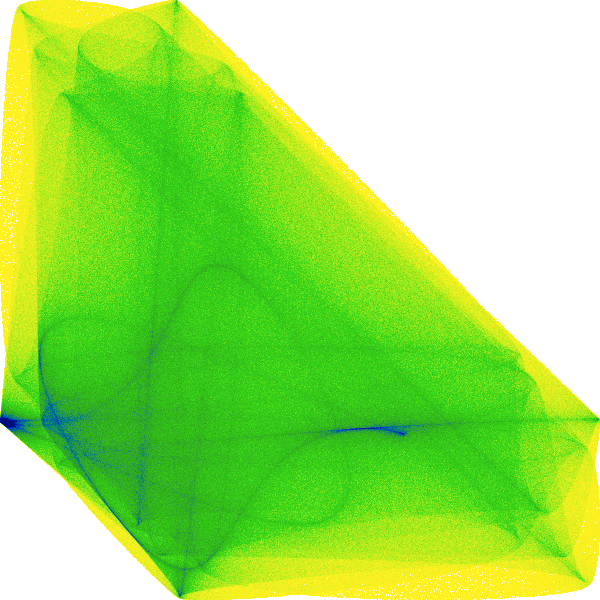
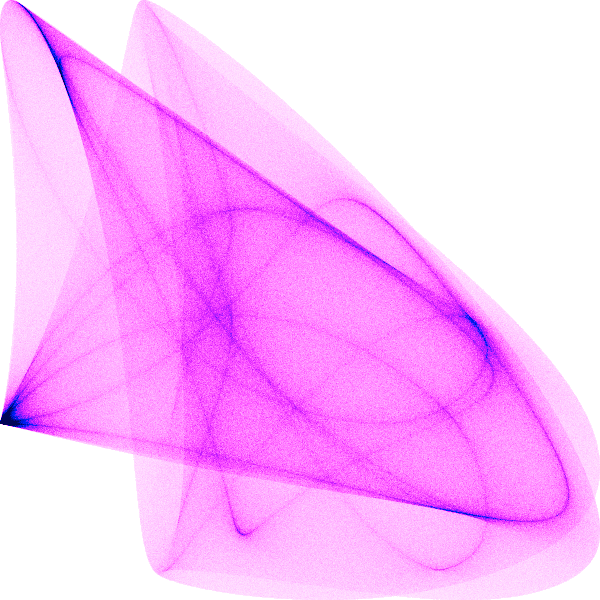
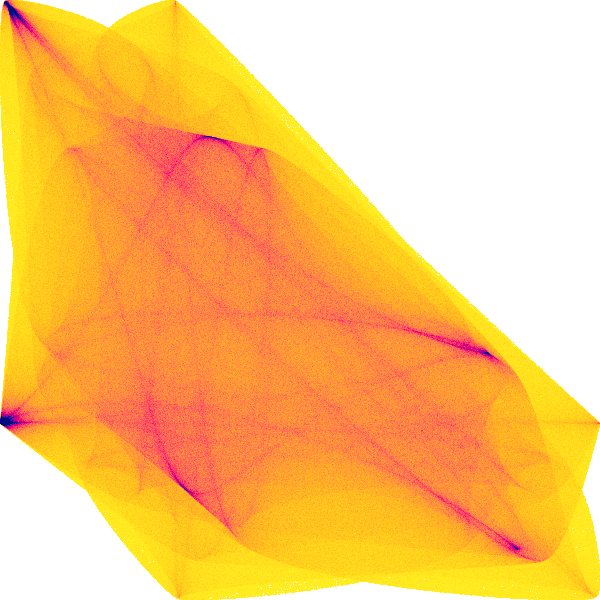
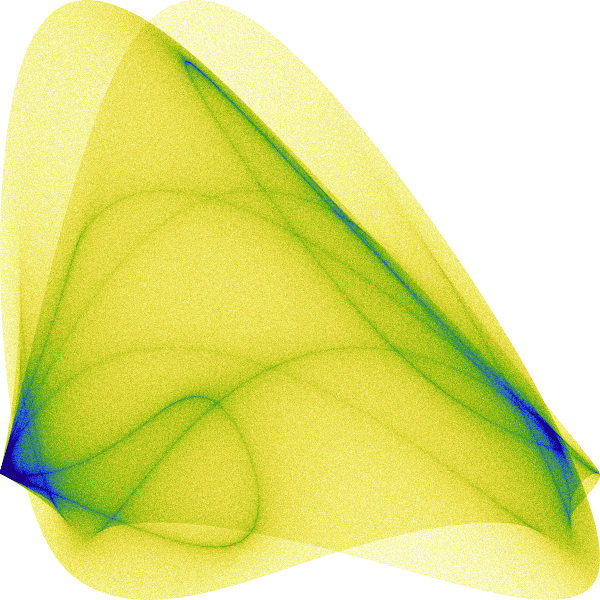
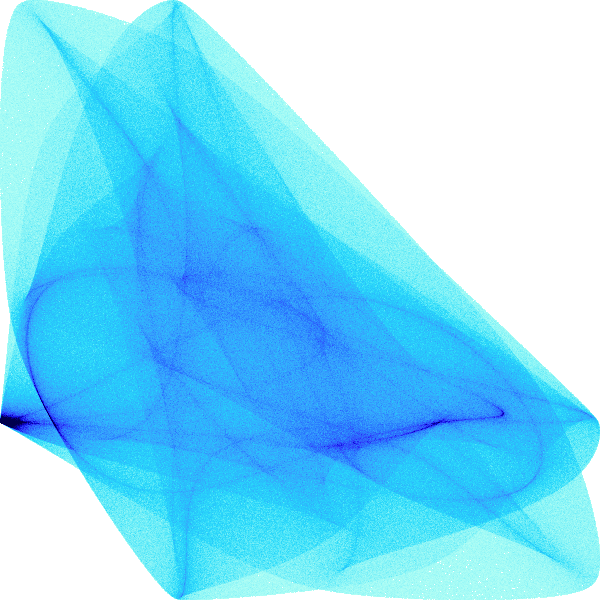
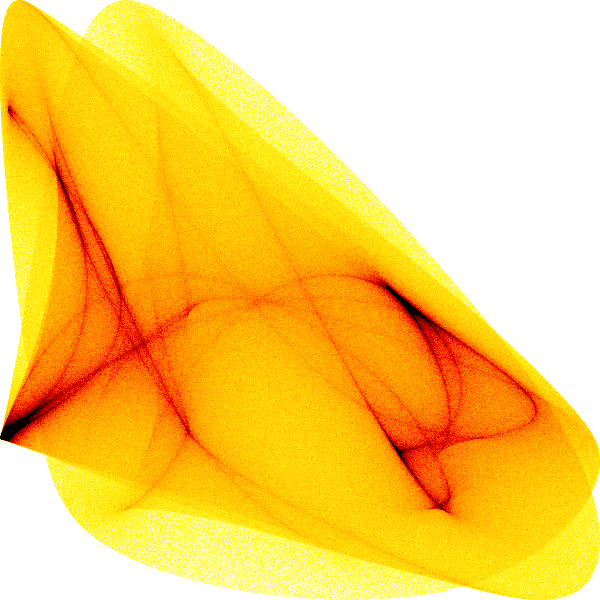
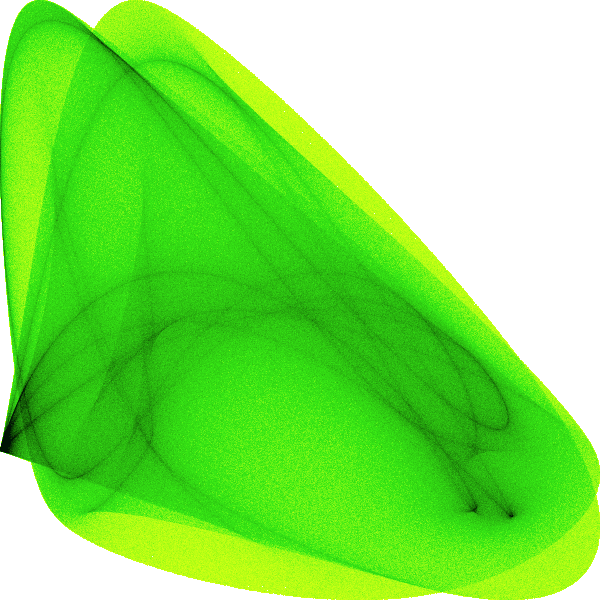
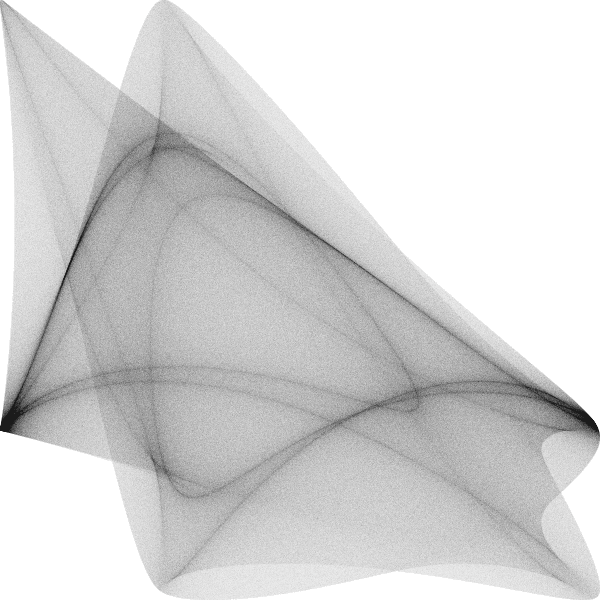
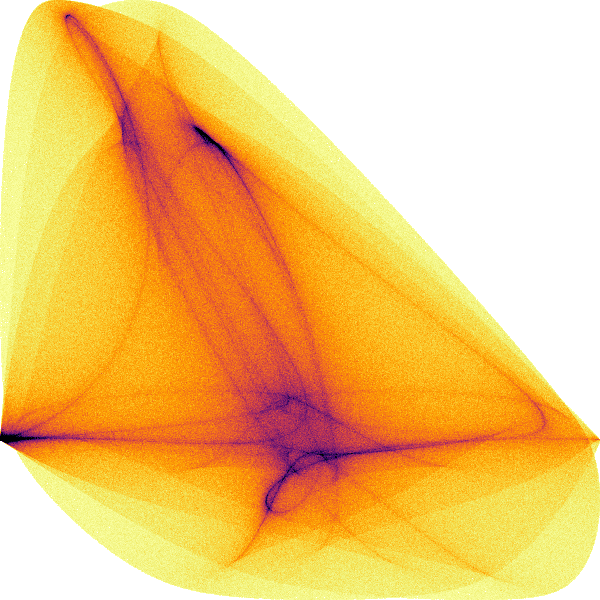
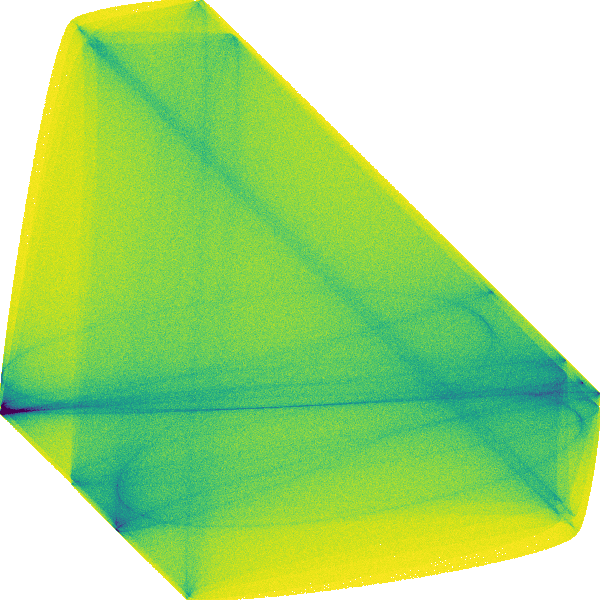

In [29]:
tf.Images(*set1).cols(5)

#### Saving each picture...

In [30]:
for indx in range(len(set1)):
    img_map(tf.dynspread(set1[indx]), "set1_u%s"%indx)

### A different `seed`

In [31]:
np.random.seed(42)
unitarias = np.array([unitaria(3) for i in range(10)])

In [32]:
set2 = [plot(unitarias[i], cmap=cmaps[i%len(cmaps)]) 
            for i in range(len(cmaps))]

,,,,
,,,,

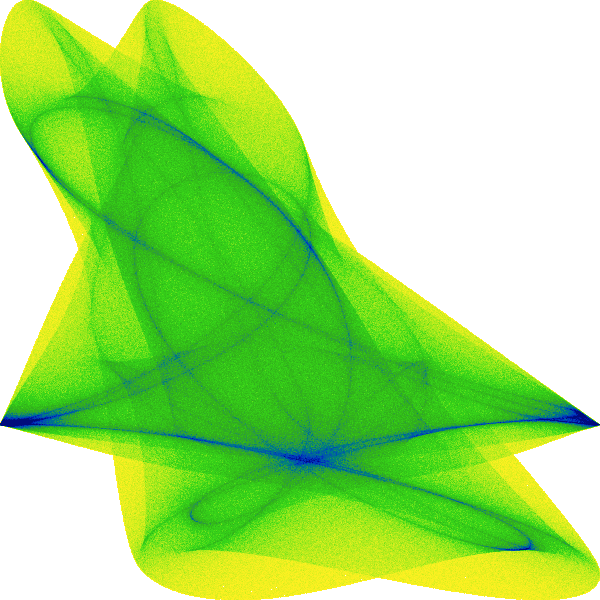
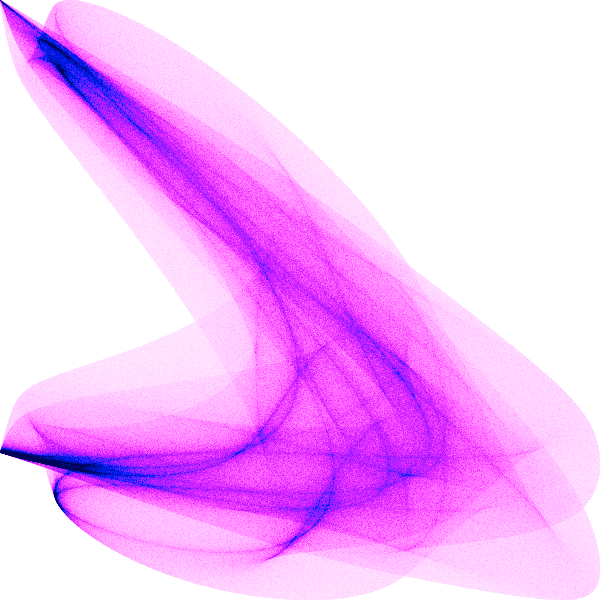
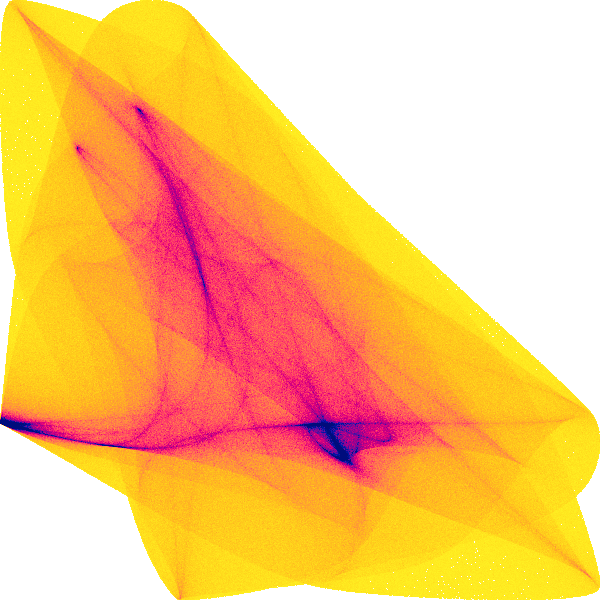
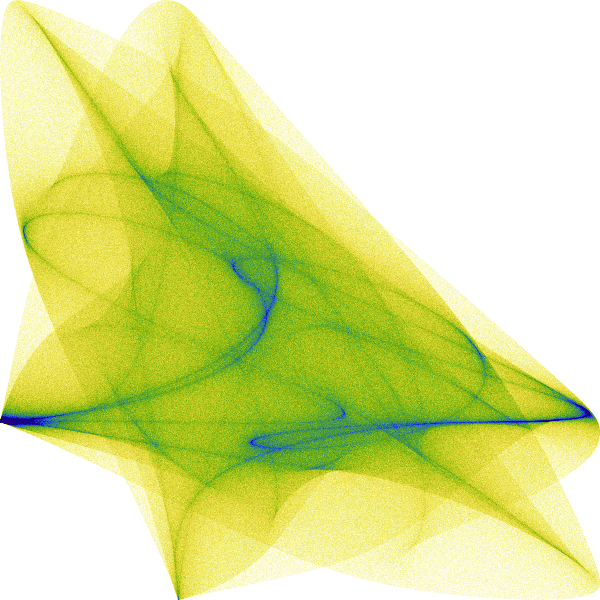
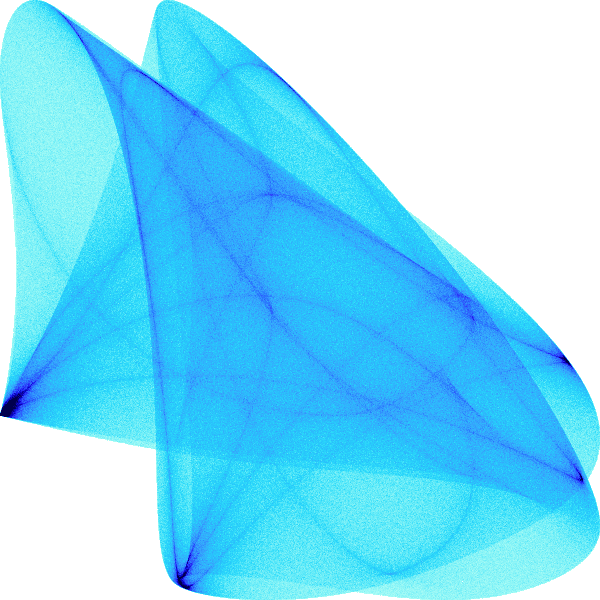
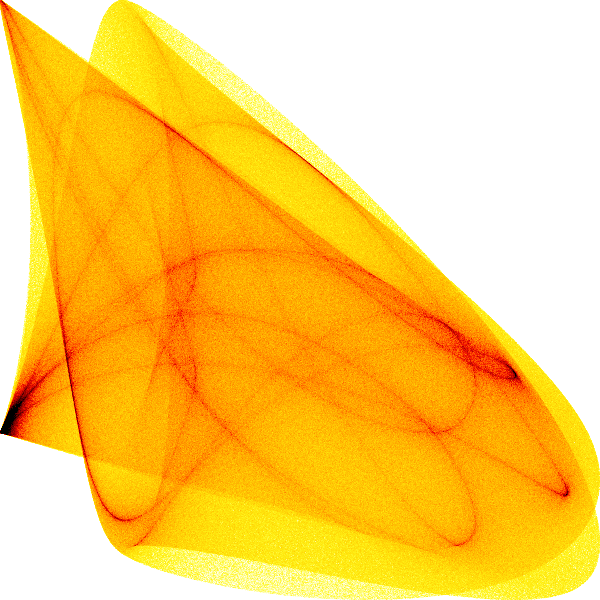
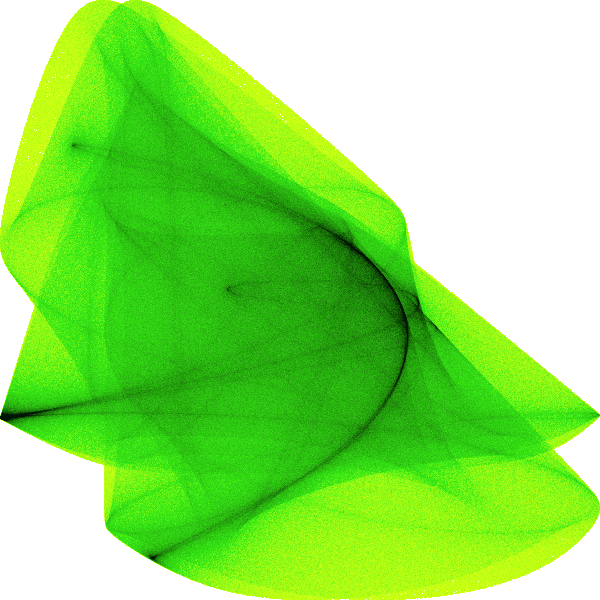
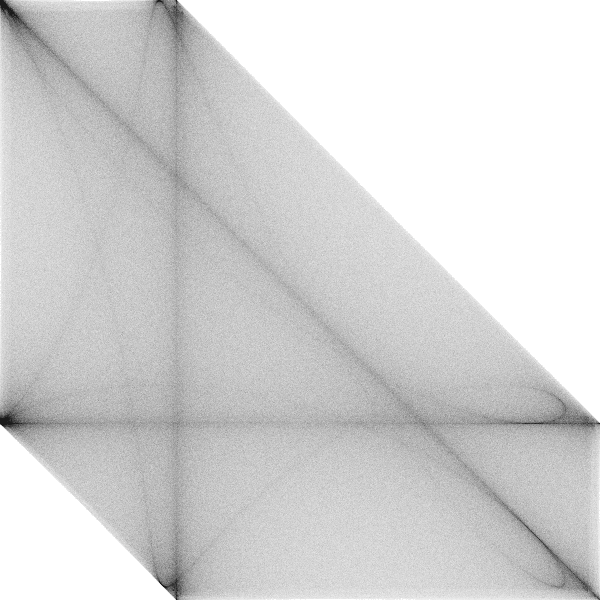
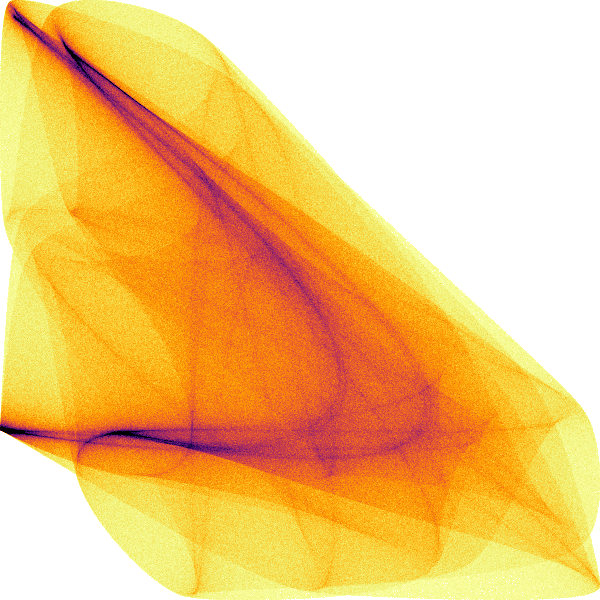
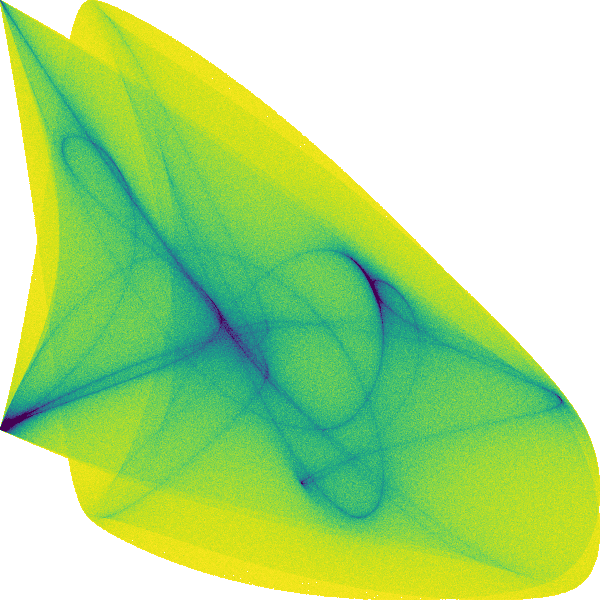

In [33]:
tf.Images(*set2).cols(5)

#### Saving each picture...

In [34]:
for indx in range(len(set2)):
    img_map(tf.dynspread(set2[indx]), "set2_u%s"%indx)

### One last `seed`

In [35]:
np.random.seed(123)
unitarias = np.array([unitaria(3) for i in range(10)])

In [36]:
set3 = [plot(unitarias[i], cmap=cmaps[i%len(cmaps)]) 
            for i in range(len(cmaps))]

,,,,
,,,,

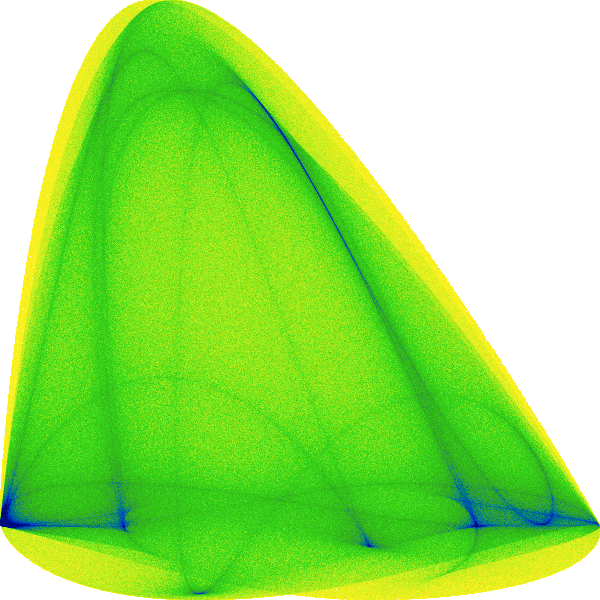
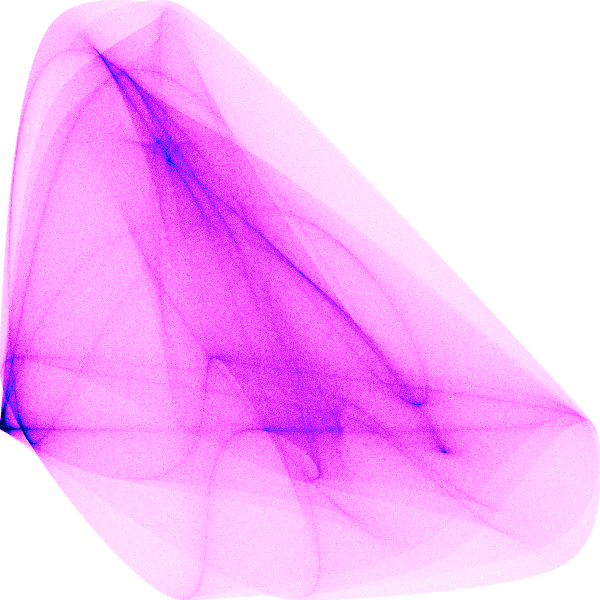
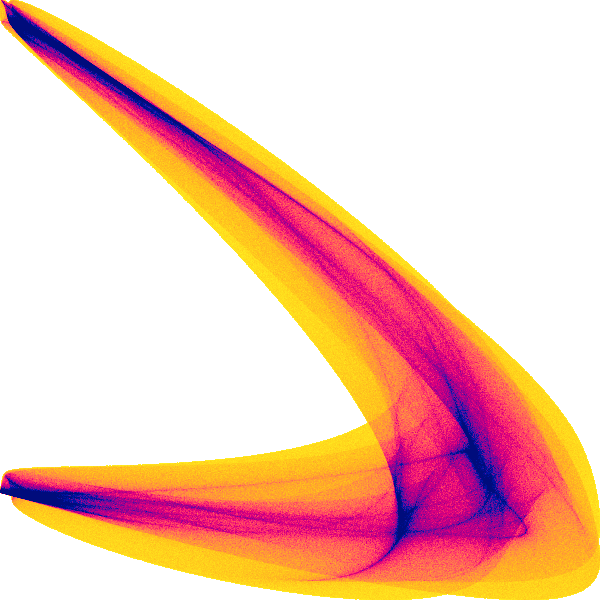
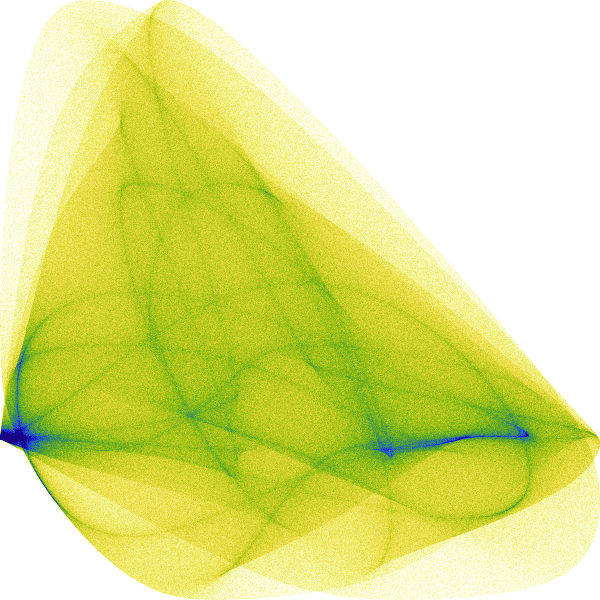
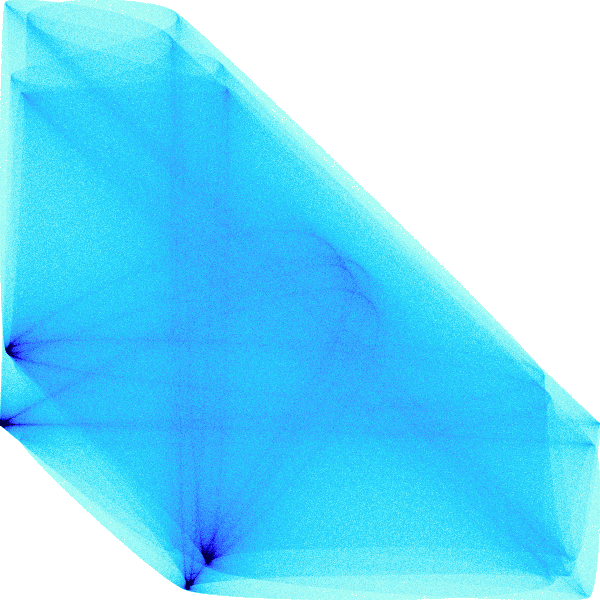
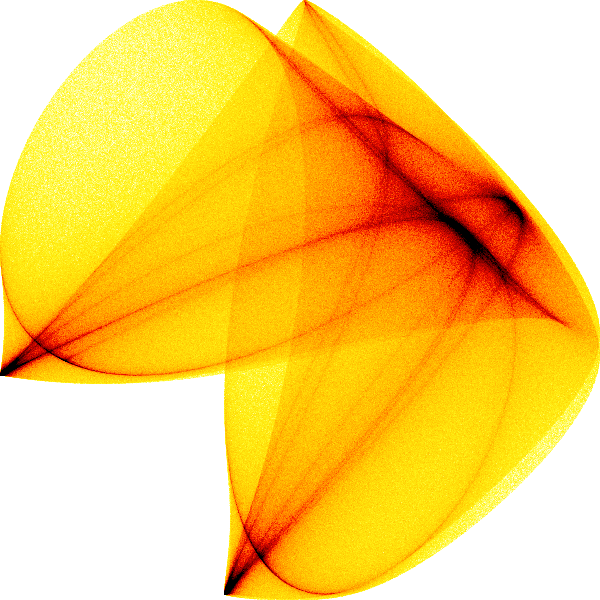
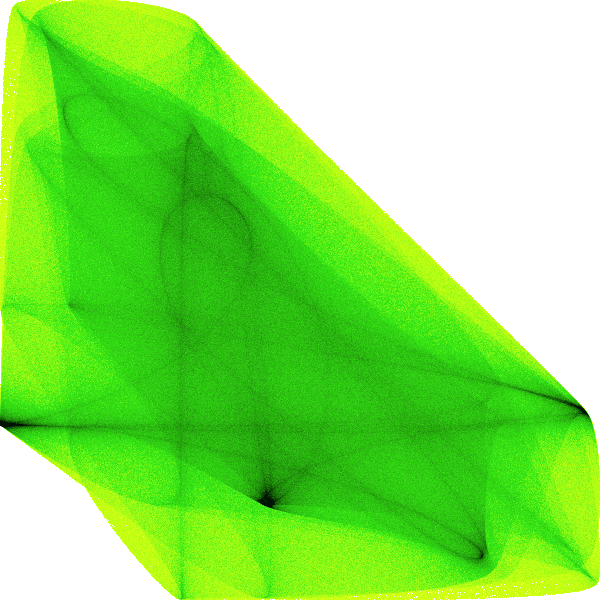
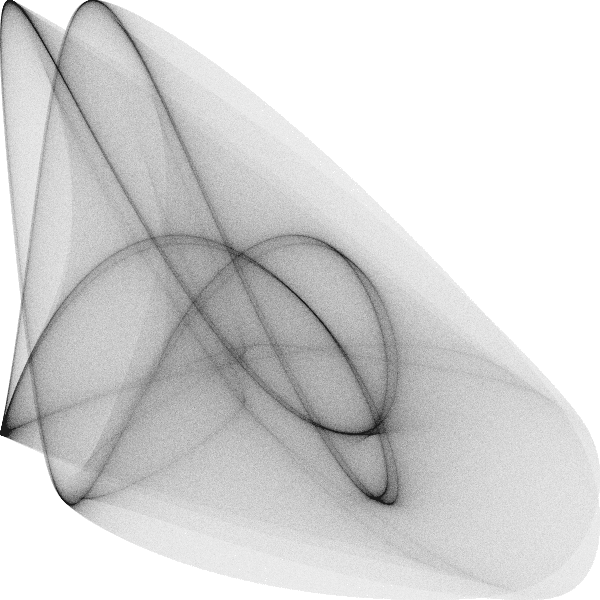
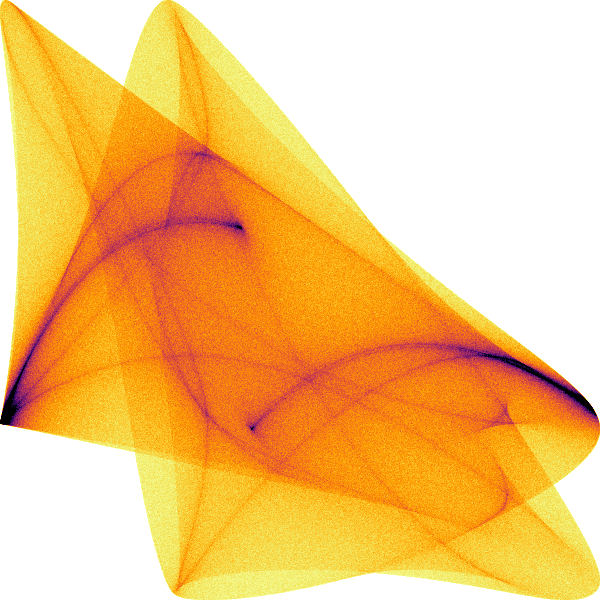
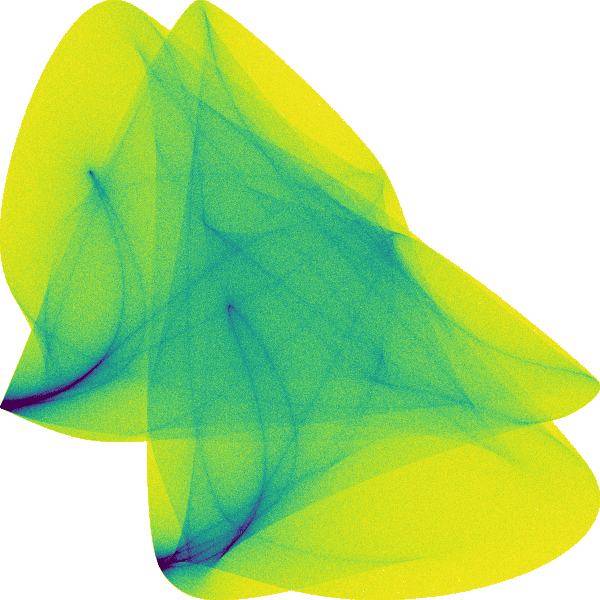

In [37]:
tf.Images(*set3).cols(5)

#### Saving each picture...

In [38]:
for indx in range(len(set3)):
    img_map(tf.dynspread(set3[indx]), "set3_u%s"%indx)

## Special  cases

So far, we had been only considering random unitary matrices, however there are some special cases, which are well known in the literature. Next, we consider [Hadamard gates](https://en.wikipedia.org/wiki/Quantum_logic_gate) around the axis $x$, $y$ and $z$, as well as the so called [Fourier matrix](http://mathworld.wolfram.com/FourierMatrix.html) and, the [CKM](https://en.wikipedia.org/wiki/Cabibbo%E2%80%93Kobayashi%E2%80%93Maskawa_matrix) and [PMNS](https://en.wikipedia.org/wiki/Pontecorvo–Maki–Nakagawa–Sakata_matrix) matrix, relevants in particle physics. The last two are approximations, since the entries are calculated with some parameters that are obtained experimentally.

### Hadamard Gates

In [39]:
h1 = np.array([[1, 0, 0],[0, 1/np.sqrt(2), 1/np.sqrt(2)],[0, 1/np.sqrt(2), -1/np.sqrt(2)]])
h2  = np.array([[1/np.sqrt(2), 0, 1/np.sqrt(2)],[0, 1, 0 ],[1/np.sqrt(2), 0, -1/np.sqrt(2)]])
h3 = np.array([[1/np.sqrt(2), 1/np.sqrt(2), 0],[1/np.sqrt(2), -1/np.sqrt(2), 0 ],[0, 0, 1]])

### Fourier matrix

In [40]:
f3  = np.array([[1, 1, 1],[1, -1/2 + 1j*np.sqrt(3)/2, -1/2 - 1j*np.sqrt(3)/2], 
                       [1, -1/2 - 1j*np.sqrt(3)/2, -1/2 + 1j*np.sqrt(3)/2]])/np.sqrt(3)

### [Cabibbo–Kobayashi–Maskawa matrix](https://en.wikipedia.org/wiki/Cabibbo–Kobayashi–Maskawa_matrix)
[`Wolfenstein parameterization of the CKM matrix`](https://journals.aps.org/prl/abstract/10.1103/PhysRevLett.51.1945)

In [41]:
λ, A, ρ, η  = 0.2257, 0.814, 0.135, 0.349

CKM = np.array([[1- λ**2/2, λ, A*λ**3*(ρ - 1j*η + 1j*η*λ**2/2)],
                [- λ, 1 - λ**2/2 - 1j*η*A**2*λ**4, A*λ**2*(1 + 1j*η*λ**2)],
                [A*λ**3*(1 - ρ - 1j*η), -A*λ**2, 1]])

Please also check this [link](http://physics.princeton.edu/~mcdonald/examples/EP/wolfenstein_prl_51_1945_83.pdf).

In [42]:
CKM@CKM.conj().T

array([[ 1.00066046e+00+0.00000000e+00j,  5.00425583e-05+2.51818722e-06j,
        -2.06190339e-04+0.00000000e+00j],
       [ 5.00425583e-05-2.51818722e-06j,  1.00236903e+00+0.00000000e+00j,
        -7.70980699e-04+2.48821553e-05j],
       [-2.06190339e-04+0.00000000e+00j, -7.70980699e-04-2.48821553e-05j,
         1.00179560e+00+0.00000000e+00j]])

#### It seems that the measured values are good enough to have an unitary matrix(approx).

### [Pontecorvo–Maki–Nakagawa–Sakata matrix](https://en.wikipedia.org/wiki/Pontecorvo–Maki–Nakagawa–Sakata_matrix)

In [43]:
θ12 = (33.56/180)*np.pi
θ23 = (41.6/180)*np.pi
θ13 = (8.46/180)*np.pi
δCP = (261/180)*np.pi
s12 = np.sin(θ12)
s23 = np.sin(θ23)
s13 = np.sin(θ13)

c12 = np.cos(θ12)
c23 = np.cos(θ23)
c13 = np.cos(θ13)

PMNS = np.array([[c12 * c23, s12 * c13, s13 * np.exp(-1j * δCP)],
                [-s12 * c23 - c12 * s23 * s13 * np.exp(1j * δCP), 
                 c12 * c23 - s12 * s23*s13*np.exp(1j * δCP), s23*c13],
                [s12 * s23 - c12 * c23 * s13 * np.exp(1j * δCP),
                 -c12 * s23 - s12 * c23 * s13 * np.exp(1j * δCP), c23 * c13]])

Take a look at this [link](https://arxiv.org/pdf/1710.00715.pdf) and this [link](https://arxiv.org/pdf/hep-ph/0608101.pdf). 

In [52]:
PMNS@PMNS.conj().T

array([[ 0.70893894+0.        j,  0.08056992+0.0161664 j,
        -0.07669062+0.01820865j],
       [ 0.08056992-0.0161664 j,  1.        +0.        j,
         0.        +0.        j],
       [-0.07669062-0.01820865j,  0.        +0.        j,
         1.        +0.        j]])

#### So, it's not really an unitary matrix(it should be, according to the formulation), but still, let's see how this turns out. 

In [45]:
unitarias2 = np.array([h1, h2, h3, f3, CKM, PMNS])

In [ ]:
set4 = [plot(unitarias2[i], cmap=cmaps[i%len(cmaps)]) 
            for i in range(6)]

,,,,,

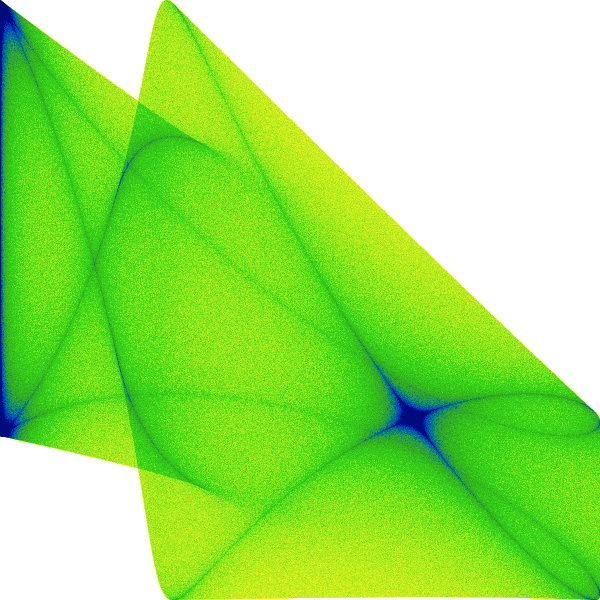
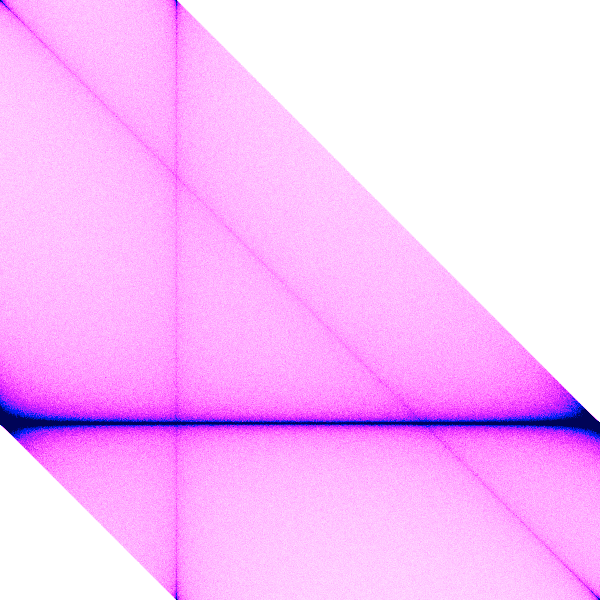
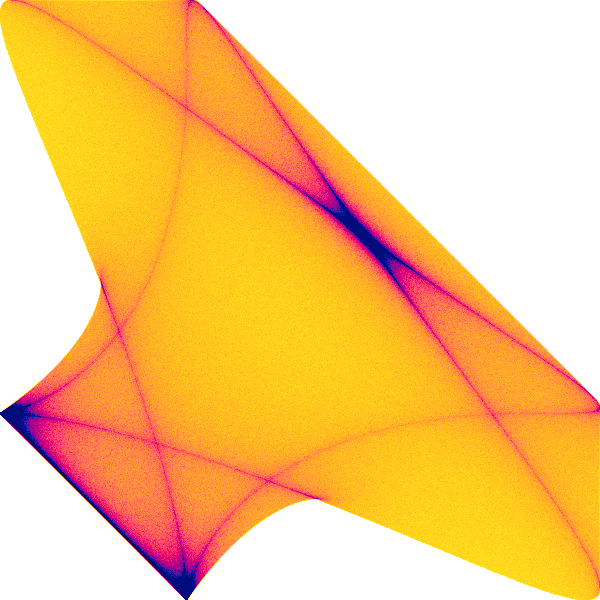
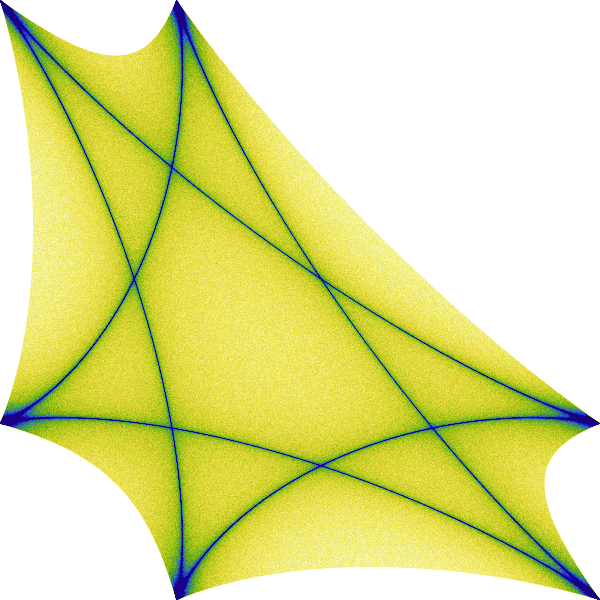
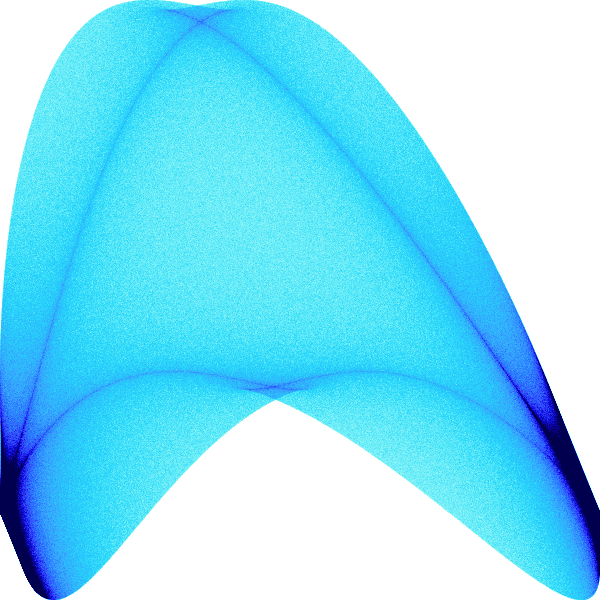
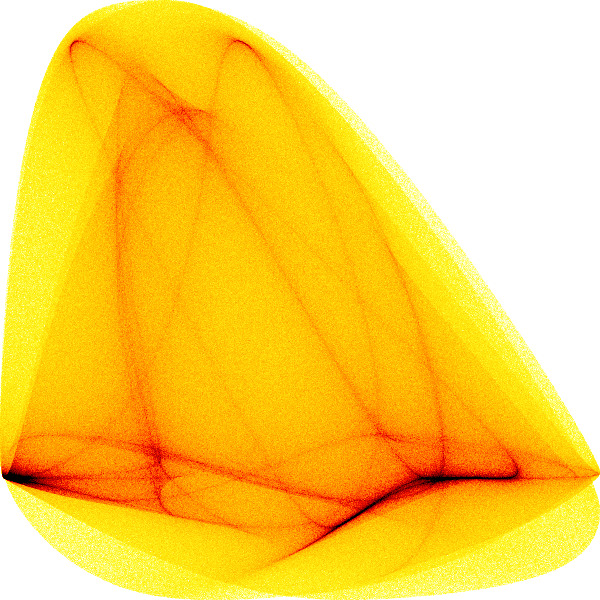

In [48]:
tf.Images(*set4).cols(6)

#### Saving each picture...

In [49]:
namesSet4 =  ["H1", "H2", "H3", "F3", "CKM", "PMNS"]

In [50]:
for indx, name in enumerate(namesSet4):
    img_map(tf.dynspread(set4[indx]), name)

<p style="text-align:justify">
So, once an unitary matrix has been chosen, the distribution of partial overlaps given above it will always be the same, i.e. a `fingerprint` for the mixed quantum state.  </p>

**Packages, version control**

In [51]:
print(f"Python version: {sys.version}")
print(" ")
print("numpy == ", np.__version__)
print("pandas == ", pd.__version__)
print("datashader == ", ds.__version__)
print("numba == ", numba.__version__)
print(" ")

Python version: 3.6.4 |Anaconda custom (64-bit)| (default, Jan 16 2018, 12:04:33) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]
 
numpy ==  1.14.0
pandas ==  0.22.0
datashader ==  0.6.5
numba ==  0.36.2
 
